In [ ]:
!git clone https://github.com/KossBoii/RoadDamageDetection.git

Cloning into 'RoadDamageDetection'...
remote: Enumerating objects: 745, done.
remote: Counting objects: 100% (102/102), done.
remote: Compressing objects: 100% (70/70), done.
remote: Total 745 (delta 35), reused 89 (delta 28), pack-reused 643
Receiving objects: 100% (745/745), 220.05 MiB | 16.47 MiB/s, done.
Resolving deltas: 100% (146/146), done.
Checking out files: 100% (125/125), done.


In [ ]:
!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 33.5 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=7f63fca49afaba9341a8b704e485c71eee4f36f81379bc77671859d530cb9cbf
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
torch:  1.10 ; cuda:  cu111
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 539 kB/s 
     |████████████████████████████████| 147 kB 33.0 MB/s 
     |████████████████████████████████| 50 kB 7.5 MB/s 
     |████████████████████████████████| 74 kB 4.2 MB/s 
     |████████████████████████████████| 130 kB 78.5 MB/s 
     |████████████████████████████████| 843 kB 52.1 MB/s 
     |██████████████████████████████

In [ ]:
%cd RoadDamageDetection

/content/RoadDamageDetection


In [ ]:
!python3 train.py --training-dataset=road --backbone="COCO-InstanceSegmentation/mask_rcnn_R_50_C4_1x.yaml" \
          SOLVER.MAX_ITER 100 \
          SOLVER.CHECKPOINT_PERIOD 50

Command Line Args: Namespace(backbone='COCO-InstanceSegmentation/mask_rcnn_R_50_C4_1x.yaml', config_file='', dist_url='tcp://127.0.0.1:49152', eval_only=False, machine_rank=0, num_gpus=1, num_machines=1, opts=['SOLVER.MAX_ITER', '100', 'SOLVER.CHECKPOINT_PERIOD', '50'], resume=False, training_dataset='road')
Done Registering the dataset!
Done creating folder `output`
Done creating output folder `model_1` for current model
[04/22 21:52:14 detectron2]: Rank of current process: 0. World size: 1
[04/22 21:52:15 detectron2]: Environment info:
----------------------  ----------------------------------------------------------------
sys.platform            linux
Python                  3.7.13 (default, Mar 16 2022, 17:37:17) [GCC 7.5.0]
numpy                   1.21.6
detectron2              0.6 @/usr/local/lib/python3.7/dist-packages/detectron2
Compiler                GCC 7.3
CUDA compiler           CUDA 11.1
detectron2 arch flags   3.7, 5.0, 5.2, 6.0, 6.1, 7.0, 7.5, 8.0, 8.6
DETECTRON2_ENV_MO

In [ ]:
from utils import *
import os

def config():
	# load config from file and command-line arguments
	cfg = get_cfg()
	cfg.merge_from_file('./output/model_1/config.yaml')
	# cfg.merge_from_list(args.opts)
	# Set score_threshold for builtin models
	cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.45
	cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.45
	cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH = 0.45
	cfg.TEST.DETECTIONS_PER_IMAGE = 100
	cfg.MODEL.WEIGHTS = './output/model_1/model_final.pth'
	cfg.MODEL.RPN.POST_NMS_TOPK_TEST = 1000  # originally 1000
	cfg.MODEL.RPN.PRE_NMS_TOPK_TEST = 1000  # originally 1000
	#cfg.freeze()
	return cfg

# Pre-process the annotation files
dataset_basepath = os.path.join('./dataset', 'road')
anno_path = os.path.join(dataset_basepath, 'train', 'via_export_json.json')
thing_classes = pre_process_annos(anno_path)

# Register User's Dataset
for d in ['train', 'val']:
  DatasetCatalog.register('road' + '_' + d, lambda d=d: get_dataset_dicts(os.path.join(dataset_basepath, d)))
  MetadataCatalog.get('road' + '_' + d).set(thing_classes = thing_classes)
  MetadataCatalog.get('road' + '_' + d).set(evaluator_type = 'coco')
  print('Done Registering the dataset!')

# Configuration Initialization & Setup
cfg = config()





Done Registering the dataset!
Done Registering the dataset!


/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


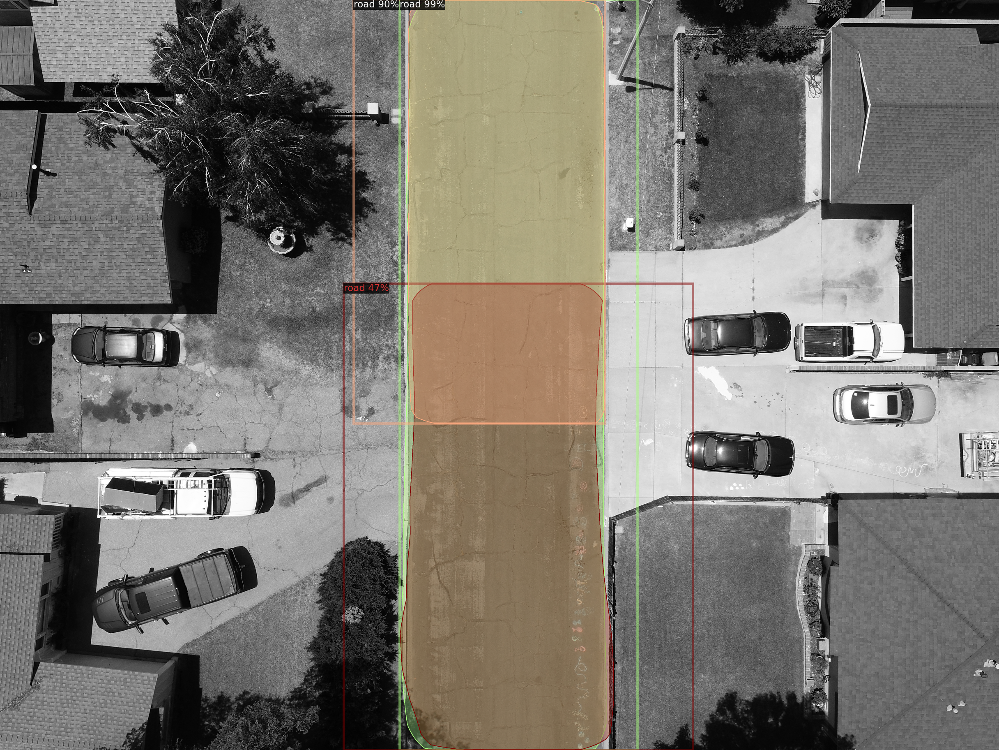

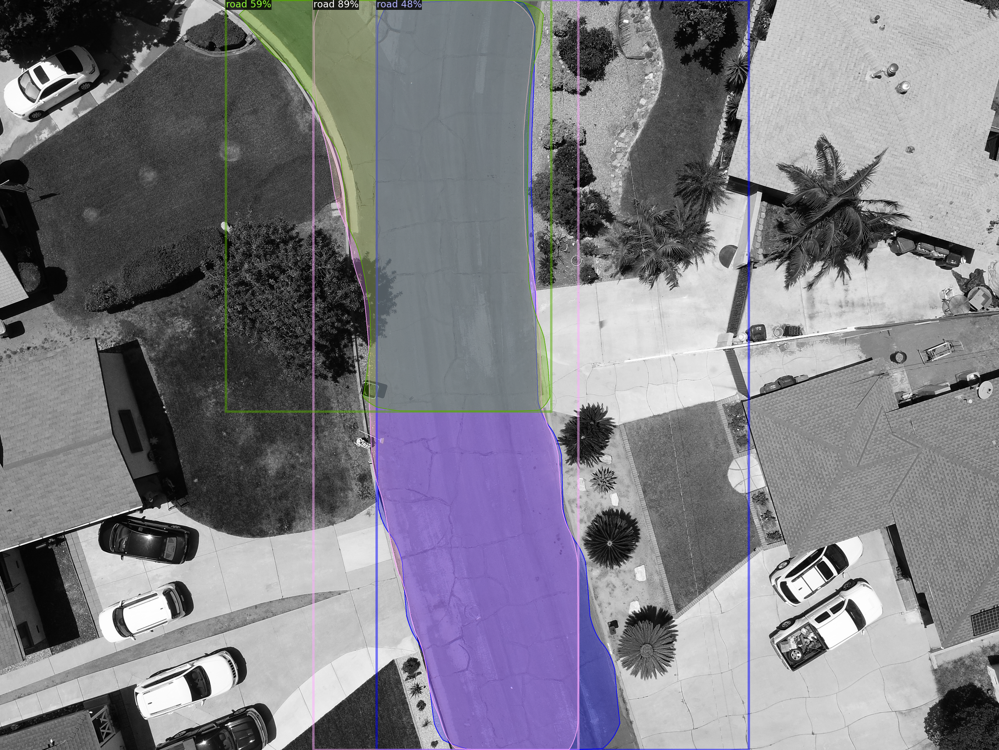

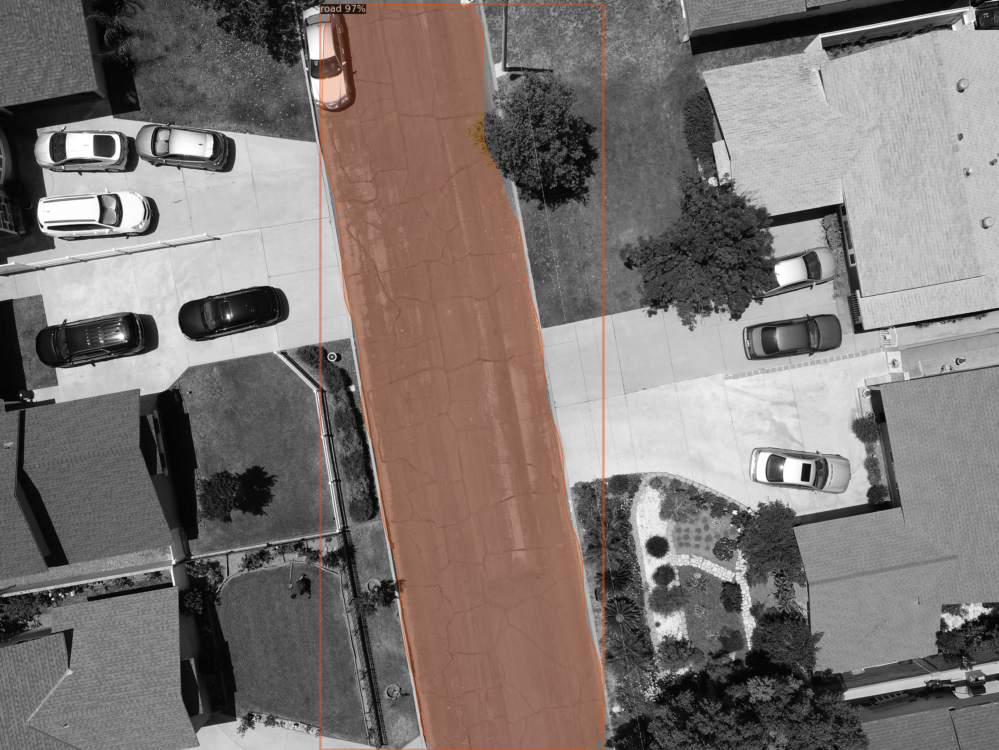

In [ ]:
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow

# Configuration Initialization & Setup
cfg = config()

predictor = DefaultPredictor(cfg)
from detectron2.utils.visualizer import ColorMode

road_metadata = MetadataCatalog.get("road_train")
dataset_dicts = get_dataset_dicts(os.path.join(dataset_basepath, 'train'))
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=road_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])



In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("road_train", output_dir="./eval_output")
val_loader = build_detection_test_loader(cfg, "road_train")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.648
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.899
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.663
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.648
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.667
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.667
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.667
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.5